# Project 1 Data Exploration and Analysis
#### 5/16/2020
#### Yang Zhang, Reannan McDaniel, Jonathan Roach, Fred Poon

In [2]:
# required libraries for this notebook
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

## Business Understanding
<!-- [10] Describe the purpose of the data set you selected (i.e., why was this data collected in the first place?). Describe how you would define and measure the outcomes from the dataset. That is, why is this data important and how do you know if you have mined useful knowledge from the dataset? How  would you measure the effectiveness of a good prediction algorithm? Be specific. -->

<!--
I used the diabetes data set from UCI machine learning repository. It has 101,766 patient records, with 55 attributes. The data was collected from 130 hospitals between the years 1999 to 2008 for regular, non-intensive-care-unit hospital admissions. The records reflect the clinical data collected during a patient's hospital stay, pertinent to the treatment of diabetes. (Since my wife has diabetes, I was interested in the type of data collected).

The purpose of the data set was to determine which characteristics of the patient and care they received had the most bearing on long-term health, which was determined by whether or not the patient was readmitted to the hospital within 30 days or after 30 days.

A good prediction algorithm would establish a relationship or correlation between a specific attribute or group of attributes with the probability of readmission to the hospital.

-->

For this analysis, our group will be working with North Carolina Public Schools Report Card and Statistical Profiles Data sets from the years 2014 to 2017. These data sets encompass information across 4 continuous years of attributes pertaining to public education in North Carolina, USA. Among other reasons, the data were collected for evaluation of public school performance for the purpose of efficiently allocating funds to various educational initiatives. Analyses of such data are important because high-impact educational initiatives that are well-funded contribute to increased graduation rates, increased achievement at the post-secondary level, less crime, and greater economic engagement among young people. For the purpose of this exercise, our focus is on describing and predicting school performance using various school characteristics, such as type of school (elementary, middle, high, or some combination of the three), social demographics, economic demographics, and location between 2014 and 2017. The Belk Foundation's website says, "Our goal is to empower today’s workforce by creating pathways to and through postsecondary education for underrepresented students". For the sake of this analysis, we assume that better performing schools have better outcomes in postsecondary education. With North Carolina's rapidly-changing demographics,it is important to take into consideration schools' unique needs when allocating funds to strategic investment initiatives. Here, we explore where funding can be best applied based on educational achievement data.

In order to achieve this goal, we will explore through visual and mathematical modeling which features best predict the School Performance Grade (SPG), a continuous measure of a school's overall success based on test scores and growth measures. The analysis will come in the form of a regression model, and accuracy of the model will be determined by the root mean-squared error (RMSE).

<!-- TODO -->
Choosing the right data set for to perform multiple types of tests across different types of data can be a challenge.  There needs to be sufficient variables, more than 30 is a good base, and about 25,000 rows of data.  The variables should include a combination of continuous and categorical variables in order to run regression or classification models.  

We decided to work with The Belk Foundation data sets from 2014 to 2017.  These data sets encompass information across 4 continuous years of educational attributes in North Carolina, USA.  The data is collected from the State of North Carlonia at http://ncpublicschools.org and made available from the Belk Endowment Educational Attainment Data Repository for North Carolina Public Schools by Dr.Jake Drew.The Belk Foundation's website says, "Our goal is to empower today’s workforce by creating pathways to and through postsecondary education for underrepresented students". For the sake of this analysis, we assume that better performing schools have better outcomes in postsecondary education. With North Carolina's rapidly-changing demographics, it is important to take into consideration schools' unique needs when allocating funds to strategic investment initiatives. Here, we explore where funding can be best applied based to educational achievement data.

For the purpose of this project our focus is around school performance grade (SPG) on multiple predictors like type of school, social demographic, economic demographics, location and school category within the years of 2014-2017.  In order to achieve this goal, we will explore through visual and mathematical modeling which features best predict the School Performance Grade (SPG) which is the measure of a school's overall success. SPG is a continuous variable generating a grade A-F.  Using regression  and **RMSE, MAE, MAPE** the model...???

## Data Understanding
### Data Meaning Type
<!-- [10] Describe the meaning and type of data (scale, values, etc.) for each attribute in the data file. -->

The data set contains 9,731 records and 259 variables that are comprised of factors, numbers and characters.  In order to scale the data to be more manageable, our data set includes 14 of the 259 variables.  These variables were chosen after initial EDA and correlation visuals were genterated between SPG and all predictors.  The data type, category and description are displayed in the following table. 
<!-- TODO -->
We begin our analysis by reading the data and displaying a small subset of the rows, as well as the data types. Naturally, with 259 attributes, a primary goal of ours is going to be to shrink down the dataset to something we can reasonably work with. More on this below.


In [3]:
schools = pd.read_csv('PublicSchools2014to2017_YZ.csv')

# schools.head()
schools[['SPG Score','avg_daily_attend_pct', 'student_num', 'tchyrs_0thru3_pct', 'MinorityFemalePct','MinorityMalePct']].head()

,SPG Score,avg_daily_attend_pct,student_num,tchyrs_0thru3_pct,MinorityFemalePct,MinorityMalePct
0,85.0,0.872,78.0,0.000,0.243243,0.067568
1,67.0,0.957,539.0,0.206,0.157699,0.163265
2,67.0,0.954,547.0,0.057,0.094096,0.107011
3,36.0,0.943,800.0,0.269,0.445980,0.463568
4,74.0,0.944,664.0,0.310,0.164134,0.173252


In [4]:
# schools.info()
schools[['SPG Score','avg_daily_attend_pct', 'student_num', 'tchyrs_0thru3_pct', 'MinorityFemalePct','MinorityMalePct']].info(verbose = True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9731 entries, 0 to 9730
Data columns (total 6 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   SPG Score             9731 non-null   float64
 1   avg_daily_attend_pct  9731 non-null   float64
 2   student_num           9731 non-null   float64
 3   tchyrs_0thru3_pct     9731 non-null   float64
 4   MinorityFemalePct     9731 non-null   float64
 5   MinorityMalePct       9731 non-null   float64
dtypes: float64(6)
memory usage: 456.3 KB


In [5]:
pd.DataFrame(schools.school_type_txt.value_counts())

,school_type_txt
Regular School,8810
Magnet School,527
Alternative Education,291
Special Education,82
Hospital School,14
0,6
Vocational Education,1


### Data Quality
<!-- [15] Verify data quality: Explain any missing values, duplicate data, and outliers. Are those mistakes? How do you deal with these problems? Give justifications for your methods. -->

#### Summary

Each raw data set is filed by academic years 2014 through 2019.  It is important to note that as of the compeletion of this project the data for the 2019 academic school year is incomplete due to the timeing of when the state of North Carolina updates the data.  With the data set for 2019 along as well as the variable names such as "szip_ad" for 2017 and prior was changed to "zip" in the 2018 and 2019 data sets and the same for "unit_code" and "agency_code" respectivaly.  In addtion to the variable names changing the manner in which the data was organized changed in 2018 and 2019 data files.  These are the deciding factors in using the data sets for academic years 2014-2017.  The data files for 2014-2017 were merged together into one usable file by academic school year.  

The following statements are refering to the data including the 14 variables mentioned previously.

The are no N/A values and there are no variables that do not have "blank" data.  However, all variables with the exception of "lea_federal_perpupil_num" and "Year" have "0" as a data point.  The variables that provide a measurement or score "0" is suitable data, these are continous variables and are left in the data file.  The categorical variables, such as "category_cd", "school_type_txt", "SPG.Grade", and "EVAAS.Growth.Status" that have "0" for data fields have to be addressed.  The amount of records that contain "0" for each one of these variables is less 600 and therefore removed for EDA.  These records make up less than 6% of the data and removing these them will not impact the analysis.

The variable category_cd has 3 records that include "0" and this non-data is immaterial.  

SPG.Grade has 370 records that include "0".  These records are only for schools that are listed as Alternative Education or Special Edcuation.  The state of North Carolina does not give these school types a score and therefore they were removed from the data set.  The predictor "EVAAS.Growth.Status" has 562 records with "0".  The "Alternative Education" school type make nearly half of these records and is the basis for removing these records.  Fortunalty the data does not have duplicates or any major outliers to address.  Once these minor changes have been completed, now the data is tidy and well prepared for EDA.

Our primary data source is a group of separate data files compiled by Dr. Drew for years 2014-2019. For convenience, we have combined the contents of the separate files together into one master file. Unfortunately, because the structure of the data is substantially different for years 2018 and 2019, these records are ommitted from the master file. 

516 records, or 5% of the data overall, have SPG Scores (our target variable) of 0 (see Visualize Attributes section for more information). Perhaps uncoincidentally, these values all correspond with a small group of elementary schools. While such a finding merits investigation, for purposes of describing factors that incfluence SPG scores, we will ignore these records for now. 
<!-- TODO -->
Our starting point is a group of established data files (from 2014 to 2019, separately) by Dr. Drew processed from raw data(cite1). Further data processing efforts are conducted to (1) to make the data files more appropriate to use for machine learning purposes (2) to combine the data files based on calendar years together.

Process (1) refer to Dr. Drew’s data cleaning scripts (cite2) including multiple imputeand cleaning process (e.g., student body racial composition imputation, highly correlated variable clean, numeric variable missing value populate as 0). For our EDA process to understand the categorical variables at ease,  we skipped the one-hot encoding part of the original code. Several code adjustments need to apply when processing data file for different years (e.g., “szip_ad” before 2017 is called “zip” 2018 and beyond, same for “unit_code” and “agency_code”).

Process (2) is conducted to merge all year-based data files together. It is found that the variable population are named quite differently 2018 and beyond, and we don’t have a full year data for 2019. For that reason, an inner join process is conducted and the resulted combined dataset has 259 columns and 9731 data lines. A new variable “Year” has been added to the merged file.

The conducted process (1) has made the data fairly clean and tidy for project use. Limited clean steps are further conducted before our EDA process. No missing values are identified. For our chosen response variable “SPG_Score” and “SPG_Grade”, a bunch of 0s are identified as the previous fillers for missing value. As we will model the response variable later, it may not appropriate to impute them.We choose to get rid of all the 0s.

Cite1: http://nbviewer.jupyter.org/github/jakemdrew/EducationDataNC/blob/master/2014/School%20Datasets/PublicSchools2014.csv

Cite2:https://nbviewer.jupyter.org/github/jakemdrew/EducationDataNC/tree/master/2014/Machine%20Learning%20Datasets/Source%20Code/PublicSchools2014_ML.ipynb

#### Data Wrangling
"Regular" schools seem to make up the majority of the dataset, so we will focus on those for now. Perhaps we can come back to the other school types later and analyze them separately.

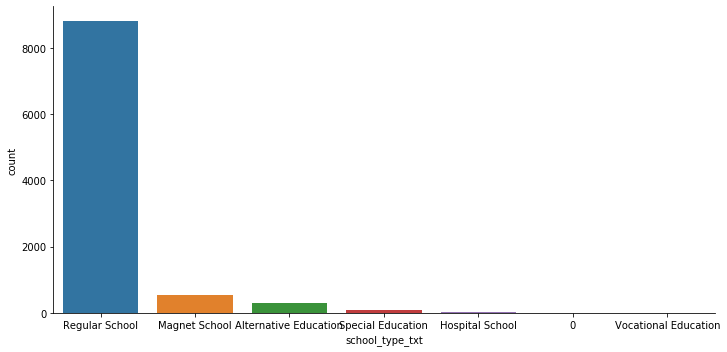

In [6]:
#Distribution of School Category
sns.factorplot("school_type_txt", data=schools, aspect=2,
                       kind="count",order = schools['school_type_txt'].value_counts().index)
plt.show()

In [7]:
# Data Frame of school type and counts
pd.DataFrame(schools["school_type_txt"].value_counts())

,school_type_txt
Regular School,8810
Magnet School,527
Alternative Education,291
Special Education,82
Hospital School,14
0,6
Vocational Education,1


In [8]:
# A second dataframe to hold just Regular Schools
schools2 = schools[schools["school_type_txt"] == 'Regular School']
pd.DataFrame(schools2["school_type_txt"].unique())

,0
0,Regular School


Let's now take a look at schools by the age ranges of their students: elementary, middle, high, and various combinations of the three.

In [9]:
schools2['category_cd'] == 'E'
schools2['category_cd_modified'] = np.select(
    [
        schools2['category_cd'] == 'A', 
        schools2['category_cd'] == 'E',
        schools2['category_cd'] == 'H',
        schools2['category_cd'] == 'I',
        schools2['category_cd'] == 'M'
    ], 
    [
        'Elem./Mid./High Together', 
        'Elementary School',
        'High School',
        'Elem./Mid. Together',
        'Middle School'
    ],
    default='Mid./High Together'
)

pd.DataFrame(schools2['category_cd_modified'].unique())


,0
0,High School
1,Elementary School
2,Middle School
3,Elem./Mid. Together
4,Mid./High Together
5,Elem./Mid./High Together


Some of these categories have very little representation in the data. For now, we'll remedy this by lumping the combo groups together.

In [10]:
combo = schools2['category_cd_modified'].str.contains('/', regex=False)

schools2['category_cd_modified'] = np.where(combo, 'Combo', schools2['category_cd_modified'])

pd.DataFrame(schools2.category_cd_modified.value_counts())

,category_cd_modified
Elementary School,4848
High School,1826
Middle School,1771
Combo,365


We now need to somehow get at the idea of demographic composition of schools. Dr. Drew and his capstone groups have shown that classifying schools as majority-minority when they are composed of >50% non-white students highlights meaningful differences in school performance (likely due to the fact that demographics can serve as a stand-in for economic measures). Let's take the same approach.

In [11]:
schools2['MinorityOverallPct'] = schools2['MinorityMalePct'] + schools2['MinorityFemalePct']

schools2['Majority_Minority'] = np.where(schools2['MinorityOverallPct'] > .5, 1,0)

pd.DataFrame(schools2['Majority_Minority'].value_counts())

,Majority_Minority
0,4833
1,3977


### Simple Statistics
<!-- [10] Visualize appropriate statistics (e.g., range, mode, mean, median, variance, counts) for a subset of attributes. Describe anything meaningful you found from this or if you found something potentially interesting. Note: You can also use data from other sources for comparison. Explain why the statistics run are meaningful. -->

It is important to understand the types of schools that are relevant to this analysis. Let's first take a look at school type and see if there are any anomolies (schools for children with disabilities, for example).

In [12]:
schools2[['SPG Score','avg_daily_attend_pct', 'student_num', 'tchyrs_0thru3_pct', 'MinorityFemalePct','MinorityMalePct', 'Majority_Minority']].describe()

,SPG Score,avg_daily_attend_pct,student_num,tchyrs_0thru3_pct,MinorityFemalePct,MinorityMalePct,Majority_Minority
count,8810.000000,8810.000000,8810.000000,8810.000000,8810.000000,8810.000000,8810.000000
mean,62.166288,0.952950,604.964813,0.220468,0.239958,0.246351,0.451419
std,15.423596,0.017202,367.486455,0.117472,0.133608,0.140209,0.497663
min,0.000000,0.803000,8.000000,0.000000,0.000000,0.000000,0.000000
25%,54.000000,0.945000,368.000000,0.138000,0.127723,0.127784,0.000000
50%,63.000000,0.953000,532.000000,0.206000,0.224177,0.227841,0.000000
75%,72.000000,0.960000,741.000000,0.286000,0.343349,0.352619,1.000000
max,100.000000,1.000000,2966.000000,1.000000,0.990476,0.991071,1.000000


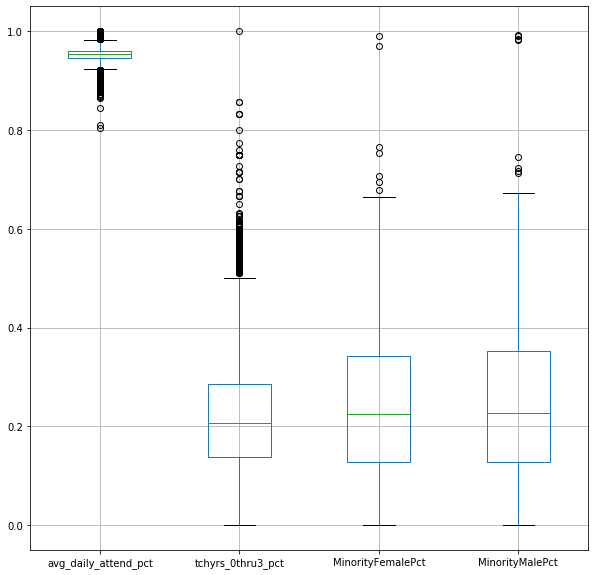

In [13]:
# visualize summary statistics on a few of the columns

schools2.boxplot(column=['avg_daily_attend_pct','tchyrs_0thru3_pct', 'MinorityFemalePct','MinorityMalePct'], figsize=(10,10))

plt.show()

### Visualize Attributes
<!-- [15] Visualize the most interesting attributes (at least 5 attributes, your opinion on what is interesting). Important: Interpret the implications for each visualization. Explain for each attribute why the chosen visualization is appropriate. -->

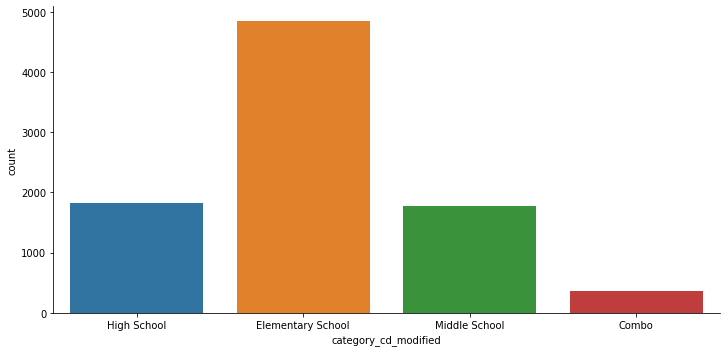

In [14]:
#Distribution of School Category
sns.factorplot("category_cd_modified", data=schools2, aspect=2,
                       kind="count")
plt.show()

#### Visualizing SPG

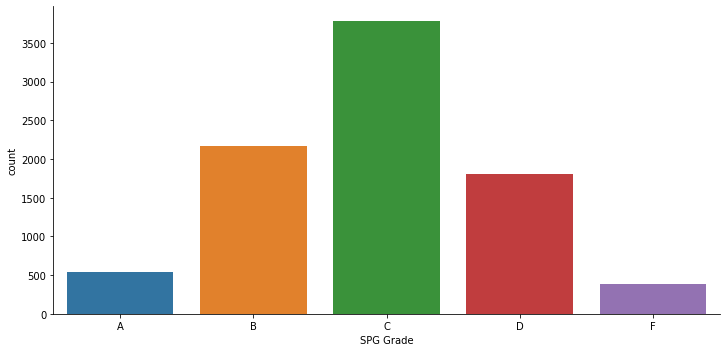

In [15]:
# First lets clean up the data to better visualize SPG
SPG = schools2[schools2['SPG Score']!=0]

remap_cat_dict = {
    'C': 'C',
    'B': 'B',
    'D': 'D',
    'F': 'F',
    'A': 'A',
    'A+NG': 'A'}

SPG["SPG Grade"] = SPG["SPG Grade"].map(remap_cat_dict).astype('category')

pd.DataFrame(SPG["SPG Grade"].value_counts())

sns.factorplot("SPG Grade", data=SPG, aspect=2,
                       kind="count", order=['A','B','C','D','F'])

plt.show()


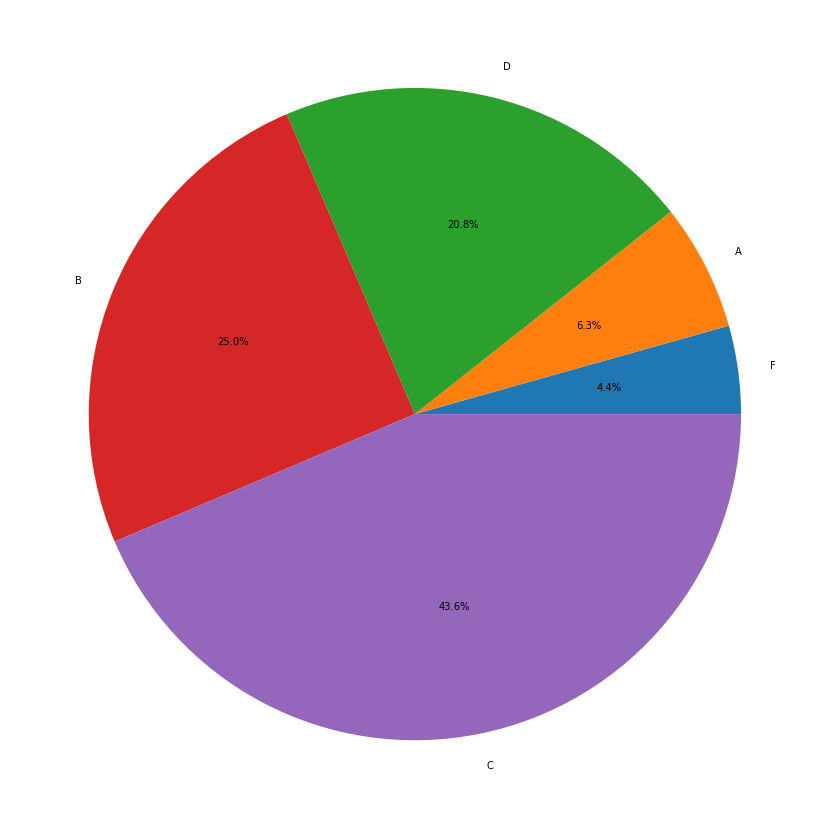

In [16]:
#Pie Plot of SPG Grade Distribution
pie_SPG = SPG.groupby('SPG Grade').agg('count')

plt.figure(1, figsize=(20,15))

SPG_labels = pie_SPG.school_type_txt.sort_values().index
SPG_counts = pie_SPG.school_type_txt.sort_values()

plt.pie(SPG_counts, labels=SPG_labels, autopct='%1.1f%%')

plt.show()

In [17]:
__A general observation:__

-The lower the grade, the higher the minority overall percentage.
-The lower the grade, the higher the short term suspensions rate.
-The lower the grade, the higher the crime rate.
-The lower the grade, the higher federal expense per pupil.
-The lower the grade, the higher the percentage of teacher with 0 to 3 years of experience.
-The lower the grade, the higher the number of the teacher proficient standard.

SyntaxError: invalid syntax (<ipython-input-17-bb47cb1e5516>, line 1)

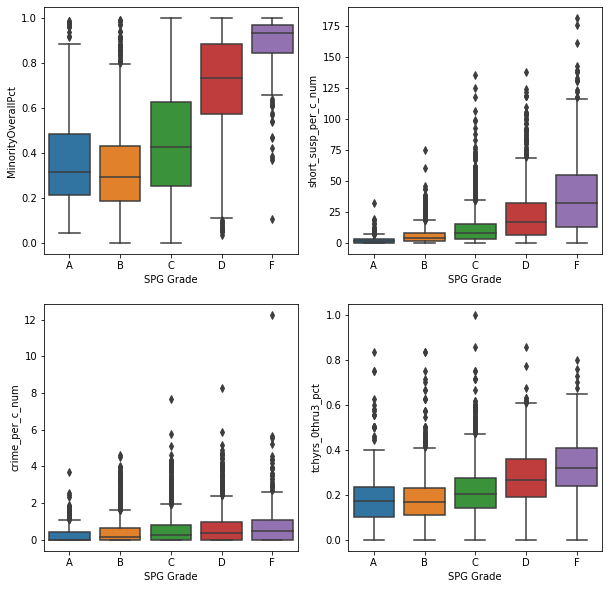

In [60]:
#Let's see the distribution of scores with different variables
f, axes = plt.subplots(2, 2,figsize=(10,10))

#SPG grade related to white percentage
sns.boxplot(  y="MinorityOverallPct", x= "SPG Grade", data=SPG,  orient='v' , ax=axes[0,0],order=['A','B','C','D','F'])

#SPG grade related to Short term suspensions per 100 students
sns.boxplot(  y="short_susp_per_c_num", x= "SPG Grade", data=SPG,  orient='v' , ax=axes[0,1],order=['A','B','C','D','F'])

#SPG grade related to Crime rate
sns.boxplot(  y="crime_per_c_num", x= "SPG Grade", data=SPG,  orient='v' , ax=axes[1,0],order=['A','B','C','D','F'])


#SPG grade related to federal funding
# sns.boxplot(  y="lea_federal_perpupil_num", x= "SPG Grade", data=SPG,  orient='v' , ax=axes[1,1],order=['A','B','C','D','F'])

#SPG grade related to teacher experience
sns.boxplot(  y="tchyrs_0thru3_pct", x= "SPG Grade", data=SPG,  orient='v' , ax=axes[1,1],order=['A','B','C','D','F'])

#SPG grade related to teacher effectiveness
# sns.boxplot(  y="Proficient_TCHR_Standard 1_Pct", x= "SPG Grade", data=SPG,  orient='v' , ax=axes[2,1],order=['A','B','C','D','F'])

plt.show()

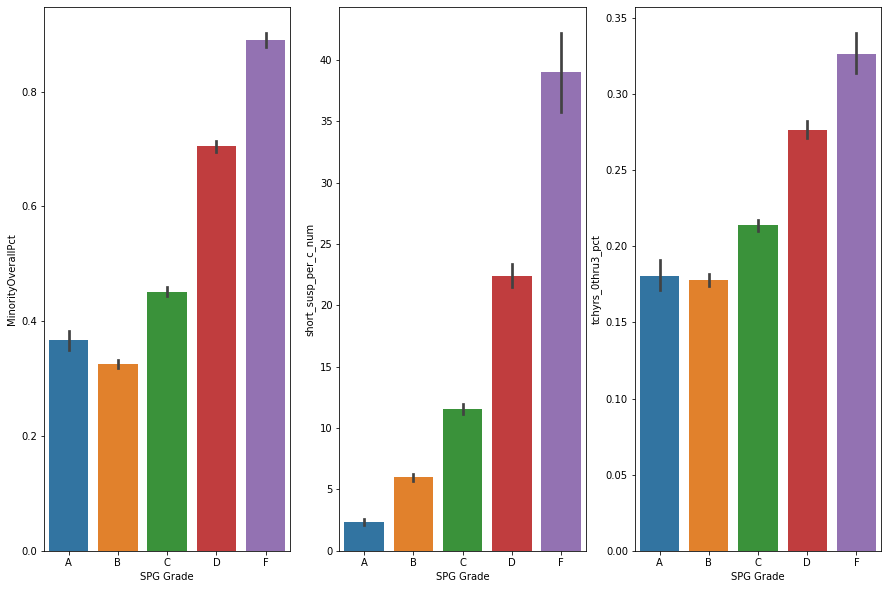

In [59]:
#Let's see the bar plots of scores with different variables

fig, axarr  = plt.subplots(1,3,figsize=(15,10))
sns.barplot(x='SPG Grade', y='MinorityOverallPct', data=SPG, order=['A','B','C','D','F'], ax=axarr[0])
sns.barplot(x='SPG Grade', y='short_susp_per_c_num', data=SPG, order=['A','B','C','D','F'], ax=axarr[1])
sns.barplot(x='SPG Grade', y='tchyrs_0thru3_pct', data=SPG, order=['A','B','C','D','F'], ax=axarr[2])
# sns.barplot(x='SPG Grade', y='Proficient_TCHR_Standard 1_Pct', data=SPG, order=['A','B','C','D','F'], ax=axarr[1,1])

plt.show()

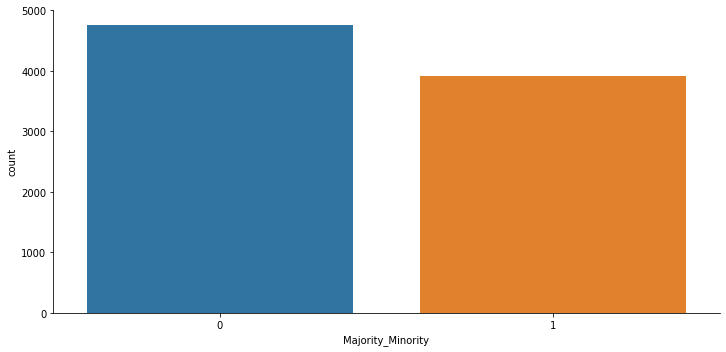

In [20]:
SPG['Majority_Minority'] = np.where(SPG['MinorityOverallPct']> .5, 1, 0)

sns.factorplot("Majority_Minority", data=SPG, aspect=2,
                       kind="count")

plt.show()

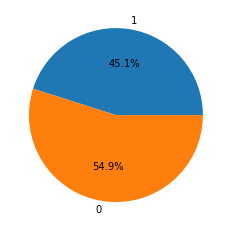

In [21]:
pie_Major = SPG.groupby('Majority_Minority').agg('count')

Major_labels = pie_Major.school_type_txt.sort_values().index
Major_counts = pie_Major.school_type_txt.sort_values()

plt.pie(Major_counts, labels=Major_labels, autopct='%1.1f%%')

plt.show()

Observation: Regular school averagely have a different minority propertion compared with magnet school.

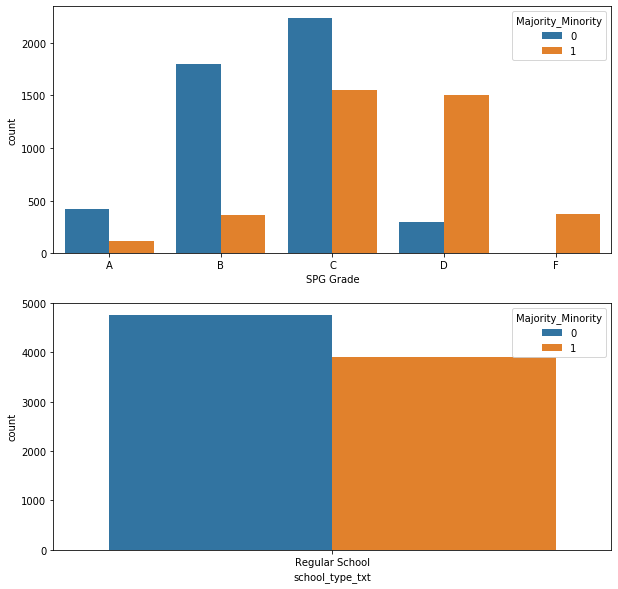

In [22]:
#Comparison of School SPG grades and types with less or more minorities in school

f, (axis1, axis2)  = plt.subplots(2, 1,figsize=(10,10))
sns.countplot(x='SPG Grade', hue='Majority_Minority', data=SPG, ax=axis1)
sns.countplot(x='school_type_txt', hue='Majority_Minority', data=SPG, ax=axis2)

plt.show()

__A general observation:__

-The lower the grade, the higher the minority overall percentage.
-The lower the grade, the larger variation the short term suspensions rate. No obvious difference between school groups.
-The lower the grade, the larger variation the crime rate.
-Slightly higher federal expense per pupil for minority schools
-Slightly higher the percentage of teacher with 0 to 3 years of experience for minority schools
-Slightly higher the number of the teacher proficient standard for minority schools
-Slightly lower science score for minority schools, with very few minority school has Grade A.

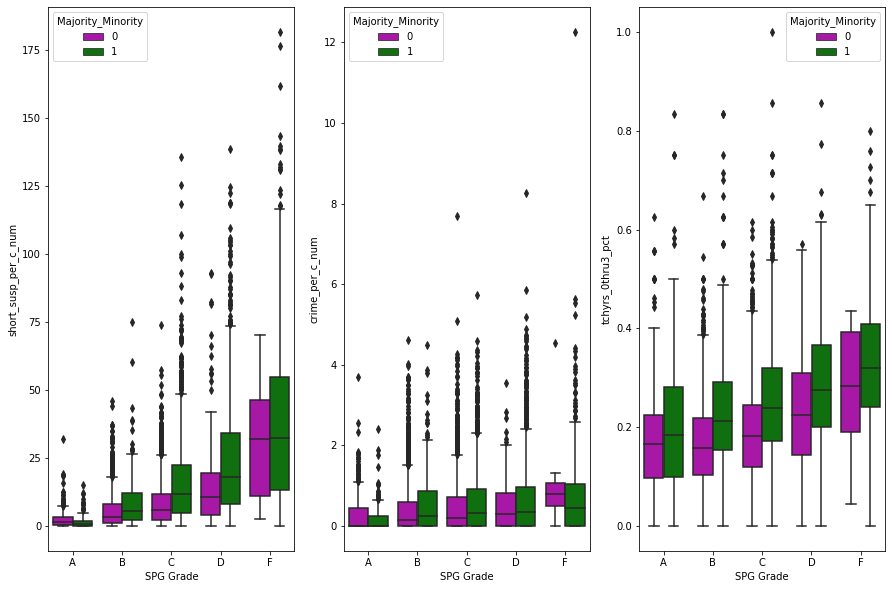

In [55]:
#Comparison of multiple variables with less or more minorities in school
f, axes = plt.subplots(1, 3,figsize=(15,10))

sns.boxplot(x= "SPG Grade", y="short_susp_per_c_num",
            hue="Majority_Minority", palette=["m", "g"],
            data=SPG, ax=axes[0], order=['A','B','C','D','F'])

sns.boxplot(x= "SPG Grade", y="crime_per_c_num",
            hue="Majority_Minority", palette=["m", "g"],
            data=SPG, ax=axes[1], order=['A','B','C','D','F'])

# sns.boxplot(x= "SPG Grade", y="lea_federal_perpupil_num",
#             hue="Majority_Minority", palette=["m", "g"],
#             data=SPG, ax=axes[1,0],order=['A','B','C','D','F'])

sns.boxplot(x= "SPG Grade", y="tchyrs_0thru3_pct",
            hue="Majority_Minority", palette=["m", "g"],
            data=SPG, ax=axes[2], order=['A','B','C','D','F'])

# sns.boxplot(x= "SPG Grade", y="Proficient_TCHR_Standard 1_Pct",
#             hue="Majority_Minority", palette=["m", "g"],
#             data=SPG, ax=axes[2,0],order=['A','B','C','D','F'])

# sns.boxplot(x= "SPG Grade", y="Science Score",
#             hue="Majority_Minority", palette=["m", "g"],
#             data=SPG, ax=axes[2,1],order=['A','B','C','D','F'])

plt.show()

With a break-up of SPG grade with Majority/Minority on Science score, we can observe:  
-Majority school has a high proportion in B and C.  
-Minority school has a high proportion in C and D.  

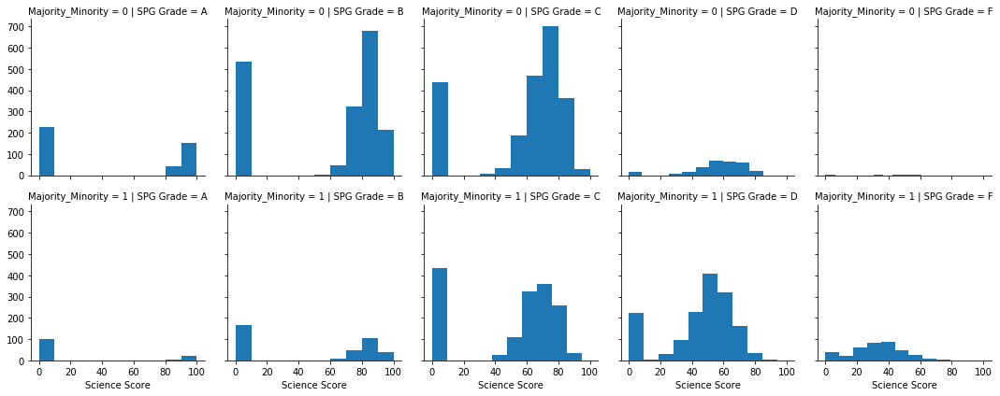

In [24]:
g = sns.FacetGrid(SPG, col="SPG Grade",  row="Majority_Minority", col_order=['A','B','C','D','F'])
g = g.map(plt.hist, "Science Score")

In [25]:
#Remap SPG_Grade to Pass and Fail

remap_cat_dict = {
    'C': 1,
    'B': 1,
    'D': 0,
    'F': 0,
    'A': 1}

SPG["SPG_Met"] = SPG["SPG Grade"].map(remap_cat_dict).astype('category')
pd.DataFrame(SPG["SPG_Met"].value_counts())


,SPG_Met
1,6494
0,2181


In [26]:
# the cross tab operator provides an easy way to get these numbers
spg_ct = pd.crosstab([ SPG['school_type_txt'],SPG['Majority_Minority'] ], 
                       SPG.SPG_Met.astype(bool))
print (spg_ct)

SPG_Met                            False  True 
school_type_txt Majority_Minority              
Regular School  0                    304   4459
                1                   1877   2035


Observation: The proportion between Majority and Minority Schools on Grade Pass/Fail is apparantly different.

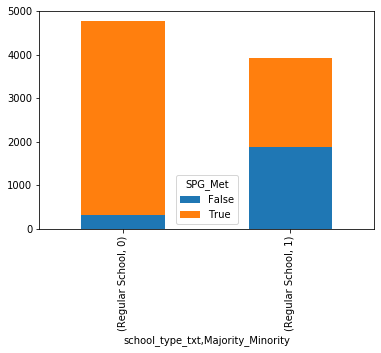

In [27]:
spg_ct.plot(kind='bar', stacked=True)

plt.show()

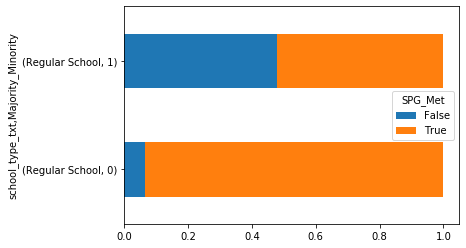

In [28]:
spg_rate = spg_ct.div(spg_ct.sum(1).astype(float),
                             axis=0) # normalize the value

# print survival_rate
spg_rate.plot(kind='barh', 
                   stacked=True)
plt.show()

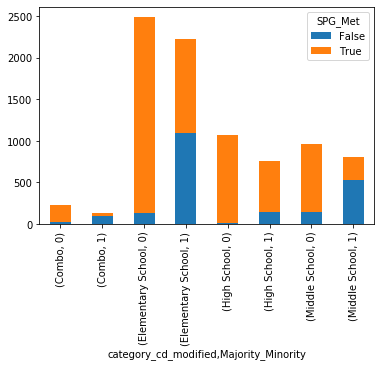

In [29]:
# the cross tab operator provides an easy way to get these numbers
spg_ct2 = pd.crosstab([ SPG['category_cd_modified'],SPG['Majority_Minority'] ], 
                       SPG.SPG_Met.astype(bool))
# print (spg_ct2)

spg_ct2.plot(kind='bar', stacked=True)
plt.show()

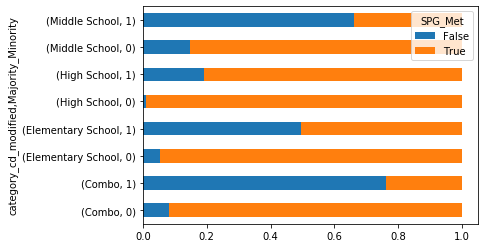

In [30]:
spg2_rate = spg_ct2.div(spg_ct2.sum(1).astype(float),
                             axis=0) # normalize the value

# print survival_rate
spg2_rate.plot(kind='barh', 
                   stacked=True)

### Explore Joint Attributes
<!-- [15] Visualize relationships between attributes: Look at the attributes via scatter plots, correlation, cross-tabulation, group-wise averages, etc. as appropriate. Explain any interesting relationships. -->

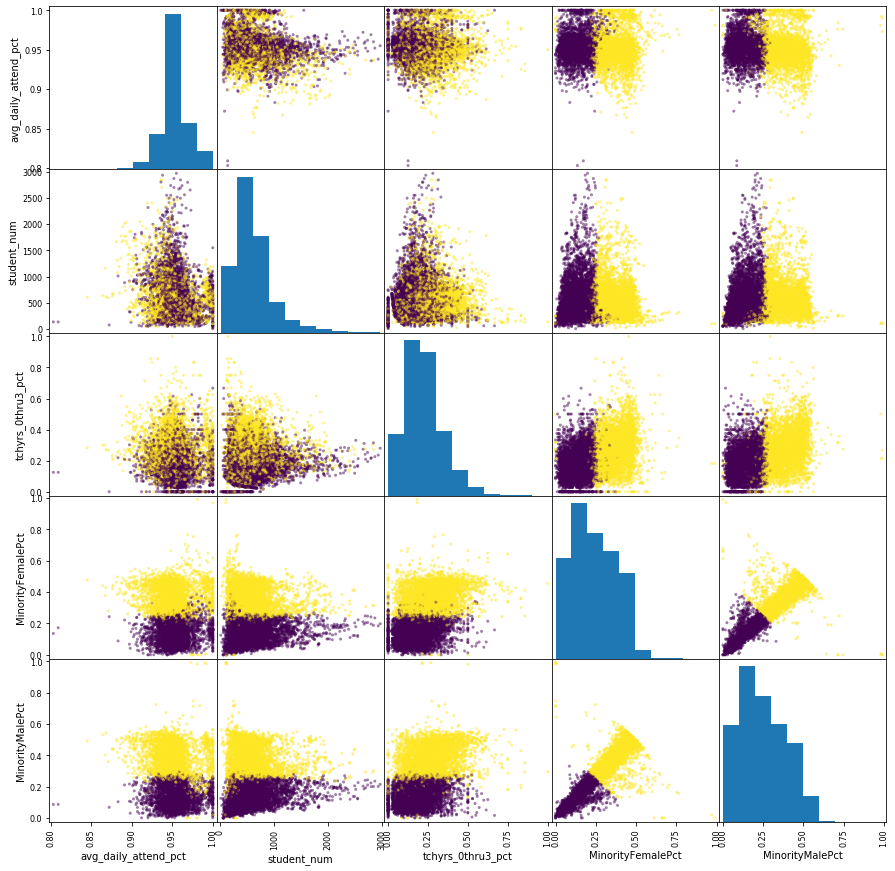

In [31]:
schools3 = schools2[['avg_daily_attend_pct', 'student_num', 'tchyrs_0thru3_pct', 'MinorityFemalePct','MinorityMalePct', 'Majority_Minority']]

pd.plotting.scatter_matrix(schools3[['avg_daily_attend_pct', 'student_num', 'tchyrs_0thru3_pct', 'MinorityFemalePct','MinorityMalePct']], c=schools3['Majority_Minority'],figsize=(15,15))

plt.show()

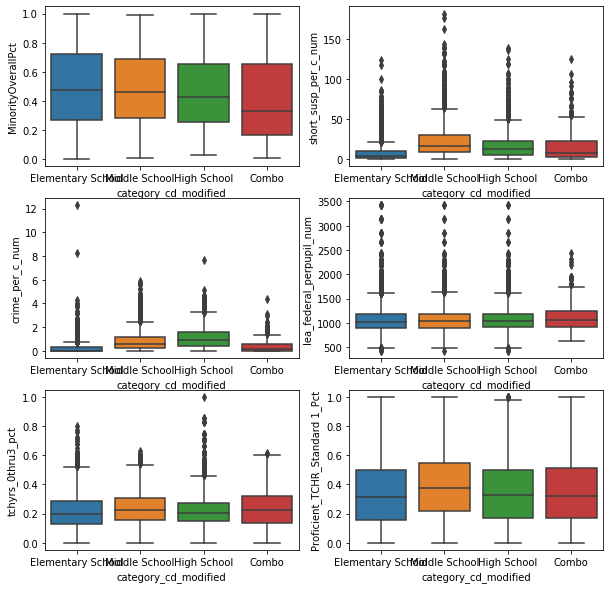

In [32]:
#Let's see the distribution of scores with different variables
f, axes = plt.subplots(, 2,figsize=(10,10))
    
#SPG grade related to white percentage
sns.boxplot(  y="MinorityOverallPct", x= "category_cd_modified", data=schools2,  orient='v' , ax=axes[0,0],order=['Elementary School','Middle School','High School','Combo'])


#SPG grade related to Short term suspensions per 100 students
sns.boxplot(  y="short_susp_per_c_num", x= "category_cd_modified", data=schools2,  orient='v' , ax=axes[0,1],order=['Elementary School','Middle School','High School','Combo'])

#SPG grade related to Crime rate
sns.boxplot(  y="crime_per_c_num", x= "category_cd_modified", data=schools2,  orient='v' , ax=axes[1,0],order=['Elementary School','Middle School','High School','Combo'])

#SPG grade related to federal funding
# sns.boxplot(  y="lea_federal_perpupil_num", x= "category_cd_modified", data=schools2,  orient='v' , ax=axes[1,1],order=['Elementary School','Middle School','High School','Combo'])

#SPG grade related to teacher experience
sns.boxplot(  y="tchyrs_0thru3_pct", x= "category_cd_modified", data=schools2,  orient='v' , ax=axes[2,0],order=['Elementary School','Middle School','High School','Combo'])

#SPG grade related to teacher effectiveness
# sns.boxplot(  y="Proficient_TCHR_Standard 1_Pct", x= "category_cd_modified", data=schools2,  orient='v' , ax=axes[2,1],order=['Elementary School','Middle School','High School','Combo'])

plt.show()


### Explore Attributes and Class
<!-- [10] Identify and explain interesting relationships between features and the class you are trying to predict (i.e., relationships with variables and the target classification). -->

Now let's do a univariate analysis on the impact of attendance rates on school performance grade. The expectation prior to doing the analysis is that poor attendance rates result in poor school performance.

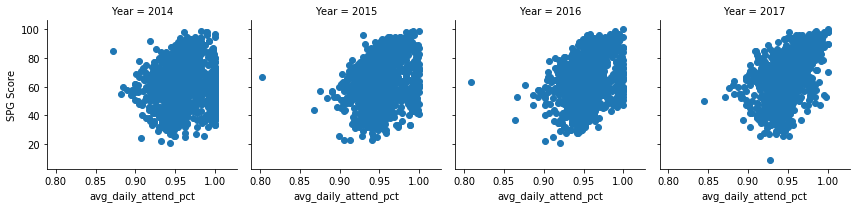

In [33]:
grid = sns.FacetGrid(SPG, col="Year")
grid.map(plt.scatter, 'avg_daily_attend_pct', 'SPG Score')

plt.show()

As expected, there is a positive correlation between the percentage of students regularly attending class and the overall quality of the school.

Some people theorize that smaller class sizes are associated with better student outcomes. Let's test that by looking at SPG score by number of students at a given school. 

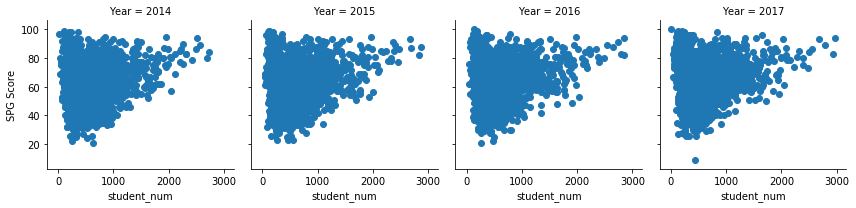

In [34]:
grid = sns.FacetGrid(SPG, col='Year')
grid.map(plt.scatter, 'student_num', 'SPG Score')

plt.show()

While this isn't a good measure of class size (we have no way of measuring student/teacher ratio. Just raw number of students), it's interesting to observe that larger public schools generally receive higher grades than smaller ones. It could be the case that here the size of the school is a stand-in for the rurality of the school. In rural areas, schools will be smaller, and there will be fewer opportunities for students. What happens when we color by the majority-minority variable? Of particular interest are high schools.

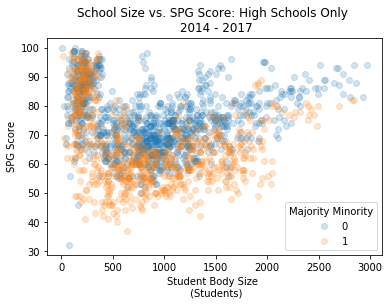

In [35]:
highschools = SPG[SPG['category_cd_modified'] == 'High School']

groups = highschools.groupby('Majority_Minority')

for name, group in groups:
    plt.plot(group["student_num"], group["SPG Score"], marker="o", linestyle="", label=name, alpha=0.2)
    plt.xlabel("Student Body Size \n (Students)")
    plt.ylabel("SPG Score")
    plt.title("School Size vs. SPG Score: High Schools Only \n 2014 - 2017")
    plt.legend(title="Majority Minority")

High schools exhibit a particularly interesting trend. There seems to be some benefit to being either an exceptionally small or large high school, but being medium sized seems to be detrimental to the overall school quality. Not sure why this would be.

Now let's turn our attention to teacher hiring. It would be reasonable to hypothesize that having teachers with more experience would result in better educational quality. Let's test it.

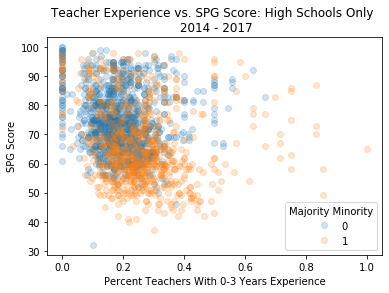

In [36]:
for name, group in groups:
    plt.plot(group['tchyrs_0thru3_pct'], group['SPG Score'], marker = "o", linestyle="", label=name, alpha=0.2)
    plt.xlabel("Percent Teachers With 0-3 Years Experience")
    plt.ylabel("SPG Score")
    plt.title("Teacher Experience vs. SPG Score: High Schools Only \n 2014 - 2017")
    plt.legend(title="Majority Minority")

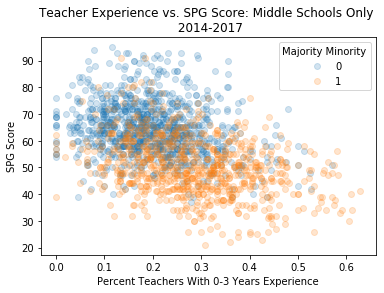

In [37]:
middleschools = SPG[SPG['category_cd_modified'] == 'Middle School']
groups_m = middleschools.groupby('Majority_Minority')

for name, group in groups_m:
    plt.plot(group['tchyrs_0thru3_pct'], group['SPG Score'], marker = "o", linestyle="", label=name, alpha=0.2)
    plt.xlabel("Percent Teachers With 0-3 Years Experience")
    plt.ylabel("SPG Score")
    plt.title("Teacher Experience vs. SPG Score: Middle Schools Only \n 2014-2017")
    plt.legend(title="Majority Minority")

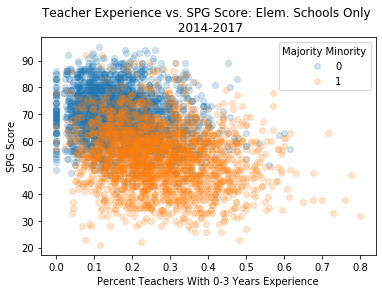

In [38]:
elemschools = SPG[SPG['category_cd_modified'] == 'Elementary School']
groups_e = elemschools.groupby('Majority_Minority')

for name, group in groups_e:
    plt.plot(group['tchyrs_0thru3_pct'], group['SPG Score'], marker = "o", linestyle="", label=name, alpha=0.2)
    plt.xlabel("Percent Teachers With 0-3 Years Experience")
    plt.ylabel("SPG Score")
    plt.title("Teacher Experience vs. SPG Score: Elem. Schools Only \n 2014-2017")
    plt.legend(title="Majority Minority")

Does disciplinary policy effect school quality? Let's take a look at suspensions. 

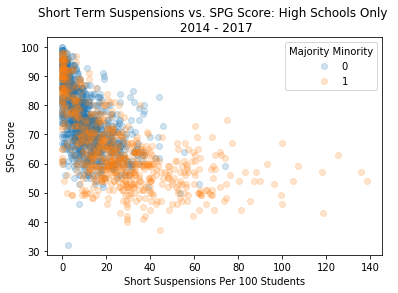

In [39]:
for name, group in groups:
    plt.plot(group['short_susp_per_c_num'], group['SPG Score'], marker = "o", linestyle="", label=name, alpha=0.2)
    plt.xlabel("Short Suspensions Per 100 Students")
    plt.ylabel("SPG Score")
    plt.title("Short Term Suspensions vs. SPG Score: High Schools Only \n 2014 - 2017")
    plt.legend(title="Majority Minority")

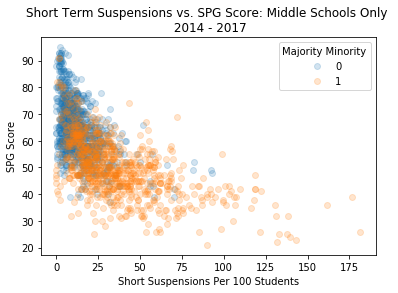

In [40]:
for name, group in groups_m:
    plt.plot(group['short_susp_per_c_num'], group['SPG Score'], marker = "o", linestyle="", label=name, alpha=0.2)
    plt.xlabel("Short Suspensions Per 100 Students")
    plt.ylabel("SPG Score")
    plt.title("Short Term Suspensions vs. SPG Score: Middle Schools Only \n 2014 - 2017")
    plt.legend(title="Majority Minority")

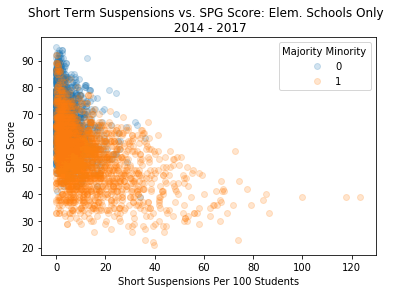

In [41]:
for name, group in groups_e:
    plt.plot(group['short_susp_per_c_num'], group['SPG Score'], marker = "o", linestyle="", label=name, alpha=0.2)
    plt.xlabel("Short Suspensions Per 100 Students")
    plt.ylabel("SPG Score")
    plt.title("Short Term Suspensions vs. SPG Score: Elem. Schools Only \n 2014 - 2017")
    plt.legend(title="Majority Minority")

### New Features
<!-- [5] Are there other features that could be added to the data or created from existing features? Which ones? -->

For other features, we can bring in data from either the GSS (General Social Survey) or the Census dataset to bring in external factors such as income % and or tax brackets. With these features we can run additional assumptions on how some of these new features affect students and their scores.

### Exceptional Work
#### Regression

In [42]:
from sklearn.model_selection import train_test_split 
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import OneHotEncoder 
from sklearn import metrics

# creating instance of one-hot-encoder
enc = OneHotEncoder(handle_unknown='ignore')

# passing category_cd_modified
enc_df = pd.DataFrame(enc.fit_transform(schools2[['category_cd_modified']]).toarray())

#Creating working dataframe for regression
X = schools2[['Majority_Minority', 'avg_daily_attend_pct', 'student_num', 'tchyrs_0thru3_pct', 'short_susp_per_c_num']]

X = pd.concat([X.reset_index(drop=True), enc_df], axis=1)

y = schools2['SPG Score']

#Split into train/test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

#Train model on training set
regressor = LinearRegression()  
regressor.fit(X_train, y_train)

y_pred = regressor.predict(X_test)

df = pd.DataFrame({'Actual': y_test, 'Predicted': y_pred})

print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

Root Mean Squared Error: 11.002376519436433


On average the model misses the SPG Score by 11 grade points.

#### Year over Year Trends
Because we combined the data provided, we were able to create trends between 2014 and 2017. First, we'll look at the trend of SPG score over these years.

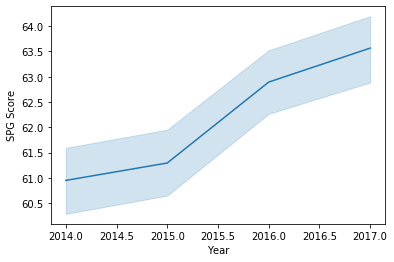

In [43]:
import seaborn as sb

schools2 = schools2[schools2["school_type_txt"]!= 0]
sb.lineplot(x="Year", y="SPG Score", data=schools2)
plt.show()

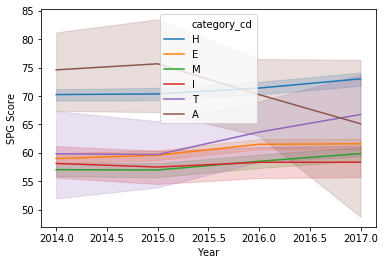

In [44]:
# trendline by category
sb.lineplot(x="Year", y="SPG Score", hue="category_cd", data=schools2)
plt.show()